<a href="https://colab.research.google.com/github/spiyer99/video_remaster/blob/master/video_remaster_train.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [16]:
!nvidia-smi

Fri Apr  2 04:40:13 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P0    30W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [6]:
from pynvml import *
nvmlInit()
h = nvmlDeviceGetHandleByIndex(0)
info = nvmlDeviceGetMemoryInfo(h)
print(f'total    : {info.total}')
print(f'free     : {info.free}')
print(f'used     : {info.used}')

total    : 17071734784
free     : 17071734784
used     : 0


In [7]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [8]:
# Colab's file access feature
from google.colab import files
uploaded = files.upload()
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json4/1AY0e-g6rg8Z4qE33tFjQj7jrGaRyZY2L4uiAL1ttUwZvlKzPyKJpWQIcgLg

Saving kaggle.json to kaggle.json
chmod: cannot access '/root/.kaggle/kaggle.json4/1AY0e-g6rg8Z4qE33tFjQj7jrGaRyZY2L4uiAL1ttUwZvlKzPyKJpWQIcgLg': No such file or directory


In [55]:
import IPython
from google.colab import output

display(IPython.display.Javascript('''
 function ClickConnect(){
   btn = document.querySelector("colab-connect-button")
   if (btn != null){
     console.log("Click colab-connect-button"); 
     btn.click() 
     }
   
   btn = document.getElementById('ok')
   if (btn != null){
     console.log("Click reconnect"); 
     btn.click() 
     }
  }
  
setInterval(ClickConnect,60000)
'''))

print("Done.")

<IPython.core.display.Javascript object>

Done.


In [10]:
!git clone https://github.com/spiyer99/colab_utils
from colab_utils.colab_utils.video import *
from colab_utils.colab_utils.files import *
from colab_utils.colab_utils.images import *

Cloning into 'colab_utils'...
remote: Enumerating objects: 78, done.
remote: Counting objects: 100% (78/78), done.
remote: Compressing objects: 100% (48/48), done.
remote: Total 78 (delta 33), reused 68 (delta 26), pack-reused 0
Unpacking objects: 100% (78/78), done.


In [11]:
#hide
import fastai
from fastai.vision import *
from fastai.callbacks import *
from fastai.utils.mem import *
from tqdm.notebook import tqdm
from torchvision.models import vgg16_bn

In [52]:
pip install youtube-dl dominate

  Using cached youtube_dl-2021.4.1-py2.py3-none-any.whl (1.9 MB)
  Using cached dominate-2.6.0-py2.py3-none-any.whl (29 kB)


# Creating the Dataset

Creating the dataset was tricky - but still doable. Here's what I did. I downloaded high quality videos into from youtube. Then I ruined them. I added black specs and reduced the resolution of the video. [Ffmpeg](https://ffmpeg.org/) was very useful in doing this. 

First we'll download the video.

In [ ]:
#hide
%cd /content
!rm -rf seinfeld
!mkdir seinfeld
!mkdir seinfeld/images

In [ ]:
#hide
path = Path('/content/seinfeld')
path_hr = path/'images'
path_lr = path/'small-96'
path_mr = path/'small-256'

In [ ]:
CLEAN_VIDEO = 'clean.mp4'
CRAPPY_VIDEO = 'crappy.mp4'

In [ ]:
!pip install -q youtube-dl moviepy ipython-autotime
!rm $CLEAN_VIDEO
# !youtube-dl --format best -o $CLEAN_VIDEO https://www.youtube.com/watch?v=R1E8C629rV0&ab_channel=SeinfeldShorts 
!youtube-dl --format best -o $CLEAN_VIDEO https://www.youtube.com/watch?v=esnMDtMysHo&ab_channel=G # starwars lightsaber
# !youtube-dl --format best -o $CLEAN_VIDEO https://www.youtube.com/watch?v=oTV2tS4nRPE&ab_channel=ComicsandStuff # star wars a new hope desert


In [ ]:
%%shell
# download grain video/
rm -Rf build
YT_GRAIN_OVERLAY="https://www.youtube.com/watch?v=J_MZb7qTenE"
mkdir -p build
youtube-dl "$YT_GRAIN_OVERLAY" -f mp4 --output "build/grain.mp4"

In [ ]:
import moviepy.editor

def get_duration_video(file):
  return moviepy.editor.VideoFileClip(file).duration

grain_film_length = get_duration_video("build/grain.mp4")
seinfeld_video_length = get_duration_video(CLEAN_VIDEO)
multiplier = int(seinfeld_video_length//grain_film_length)
multiplier

In [ ]:
seinfeld_video_length, grain_film_length

In [ ]:
# # extended grain video to entire length of seinfeld video
# !ffmpeg -loglevel warning -y -i $CLEAN_VIDEO '1.mp3'
# !ffmpeg -loglevel warning -y -stream_loop -1 -i "build/grain.mp4" -c copy -v 0 -f nut - | ffmpeg -loglevel warning -thread_queue_size 10K -i - -i 1.mp3 -c copy -map 0:v -map 1:a -shortest -y "build/grain_extended.mp4"
# # !ffmpeg -y -loglevel warning -stream_loop $multiplier -i "build/grain.mp4" -c copy "build/grain_extended.mp4"


In [ ]:
PLAYLIST = 'playlist.txt'

try:
  os.remove(PLAYLIST)
except:
  pass

def write_to_txt(text):
  file = open(PLAYLIST, "a") 
  file.write(text + '\n') 
  file.close() 

for i in range(multiplier + 1):
  write_to_txt('file build/grain.mp4')

In [ ]:
!ffmpeg -loglevel warning -y -f concat -i $PLAYLIST -c copy build/grain_extended.mp4

In [ ]:
show_short_video('build/grain_extended.mp4', seconds = 40)

build/grain_extended_short.mp4


In [ ]:
get_duration_video('build/grain_extended.mp4'), get_duration_video(CLEAN_VIDEO)

(1337.18, 1327.37)

In [ ]:
import cv2

def get_fps(file):
  cap = cv2.VideoCapture(file)
  fps = cap.get(cv2.CAP_PROP_FPS)
  return fps

fps = get_fps(CLEAN_VIDEO)
num, denom = (fps).as_integer_ratio()

In [ ]:
import datetime
clean_duration = get_duration_video(CLEAN_VIDEO)
end_time = str(datetime.timedelta(seconds=clean_duration))
end_time

'0:22:07.370000'

In [ ]:
# invert colors
!ffmpeg -loglevel warning \
        -y \
        -i "build/grain_extended.mp4" \
        -framerate $num/$denom \
        -r $num/$denom \
        -t $end_time \
        -vf negate 'color_inverted.mp4'

In [ ]:
show_short_video('color_inverted.mp4', seconds = 40)

color_inverted_short.mp4


## Run filters

In [ ]:
!ffmpeg \
    -y \
    -loglevel warning \
    -i $CLEAN_VIDEO \
    -i "color_inverted.mp4" \
    -filter_complex "[1:v][0:v]blend=all_mode='softlight':all_opacity=1" \
    -framerate $num/$denom \
    -r $num/$denom \
    -t $end_time \
    $CRAPPY_VIDEO

In [ ]:
np.testing.assert_almost_equal(get_duration_video(CRAPPY_VIDEO), get_duration_video(CLEAN_VIDEO), decimal = 0)
np.testing.assert_almost_equal(get_fps(CLEAN_VIDEO), get_fps(CRAPPY_VIDEO), decimal = 0)

In [ ]:
show_short_video(CRAPPY_VIDEO, seconds = 15)

crappy_short.mp4


In [ ]:
show_short_video(CLEAN_VIDEO, seconds = 15)

clean_short.mp4


# Extract Frames

Now we'll extract frames from each video. Initially I adopted a naive approach for doing this. Where I would do through the video in python and scrape each frame individually. But that took too long. 

We can use multi-processing here to really speed things up. This was adapted from [Hayden Faulker's](https://gist.github.com/HaydenFaulkner/54318fd3e9b9bdb66c5440c44e4e08b8#file-video_to_frames-py) script.

In [ ]:
#hide

%cd /content
!rm -Rf $path_lr
!rm -Rf $path_mr
!rm -Rf $path_hr
path_hr.mkdir(parents=True, exist_ok=True)
path_lr.mkdir(parents=True, exist_ok=True)
path_hr.mkdir(parents=True, exist_ok=True)

/content


## equal fps

In [ ]:
#hide
%%time
import math
import cv2
# Drop frame rate
def equal_fps(clean,crappy):

  cap = cv2.VideoCapture(clean)
  clean_fps = int(cap.get(cv2.CAP_PROP_FPS))
  print(clean_fps)

  # !ffmpeg -y -i $crappy -c copy -f h264 seeing_noaudio.h264
  # !ffmpeg -y -r $clean_fps -i seeing_noaudio.h264 -c copy 'crappy.mp4'
  # !rm seeing_noaudio.h264
  !ffmpeg -loglevel warning -y -i $crappy -filter:v fps=fps=$clean_fps 'crappy_fps_adjusted.mp4'

  # !ffmpeg -y -i $clean -c copy -f h264 seeing_noaudio.h264
  # !ffmpeg -y -r $clean_fps -i seeing_noaudio.h264 -c copy 'clean.mp4'
  !ffmpeg -loglevel warning -y -i $clean -filter:v fps=fps=$clean_fps 'clean_fps_adjusted.mp4'

  return 'crappy_fps_adjusted.mp4', 'clean_fps_adjusted.mp4'

crappy, clean = CRAPPY_VIDEO, CLEAN_VIDEO, 
# crappy, clean = equal_fps(CLEAN_VIDEO,CRAPPY_VIDEO)
crappy, clean

CPU times: user 11 µs, sys: 0 ns, total: 11 µs
Wall time: 13.8 µs


In [ ]:
crappy, clean

('crappy.mp4', 'clean.mp4')

In [ ]:
#hide
print(get_fps(crappy))
print(get_fps(clean))

23.976023976023978
23.976023976023978


In [ ]:
#hide
show_short_video(clean, seconds = 30)

clean_short.mp4


In [ ]:
#hide
show_short_video(crappy, seconds = 30)

crappy_short.mp4


## Frame Extractor

In [ ]:
%cd /content
video_to_frames(video_path=crappy, frames_dir=str(path_lr), overwrite=True, every=1, chunk_size=1000)
video_to_frames(video_path=clean, frames_dir=str(path_hr), overwrite=True, every=1, chunk_size=1000)

In [ ]:
import cv2

# https://stackoverflow.com/questions/33311153/python-extracting-and-saving-video-frames
def get_frames_from_video(fn, i, video_path, output_path):

  print(fn, i, video_path, output_path)
  
  vidcap = cv2.VideoCapture(video_path)
  success,image = vidcap.read()
  count = 0
  while success:
    cv2.imwrite(output_path + "/frame%d.jpg" % count, image)     # save frame as JPEG file      
    success,image = vidcap.read()
    # print('Read a new frame: ', success)
    count += 1

In [ ]:
# parallel(partial(get_frames_from_video, video_path=crappy, output_path=str(path_lr)), [1])
# parallel(partial(get_frames_from_video, video_path=clean, output_path=str(path_hr)), [1])

In [ ]:
import glob

def get_high_res_img(file):
  return str(file).replace('small-96', 'images')

def plot_img_from_path(path):
  img = PIL.Image.open(path)
  plt.figure(figsize=(10,10))
  plt.imshow(img)
  plt.show()

def plot_random_img():
  file = random.choice(crappy_files)
  plot_img_from_path(file)
  plot_img_from_path(get_high_res_img(file))

plot_random_img()

In [ ]:
plot_random_img()

## Offending files?

In [ ]:
clean_files = glob.glob(str(path_hr)+'/*.*g')
crappy_files = glob.glob(str(path_lr)+'/*.*g')

offending_files = sorted([file for file in crappy_files if file.replace('small-96', 'images') not in clean_files],\
                         key = lambda x: int(Path(x).stem))
# if len(offending_files) == 0:
#   offending_files = [file for file in clean_files if file not in crappy_files]

print(len(offending_files))

if len(offending_files) > 0:
  for file in random.sample(offending_files,min(len(offending_files),10)):
    plot_img_from_path(file)


In [ ]:
# 100 frames = 5 seconds
FRAME_INCREMENT = 100/5

def _fill_in_starting__zeroes(increment, end):
  increment, end = str(increment), str(end)
  while len(end) > len(increment): increment = '0' + increment
  return increment

def plot_frames_every(increment_seconds = 5*60, verbose = False):

  crappy_files_sorted = sorted(crappy_files, key = lambda x: int(Path(x).stem))
  end = str(Path(crappy_files_sorted[-1]).stem)
  
  if verbose: print(f'end is {end}')

  for i in range(0, int(end), increment_seconds):
    increment_frames = int(FRAME_INCREMENT*i)
    filename = _fill_in_starting__zeroes(increment_frames, end)
    if verbose: print(f'filename is {filename}')
    look_for = str(Path(crappy_files_sorted[0]).parents[0]/filename) + '*'
    if verbose: print(look_for)
    file = glob.glob(look_for)[0]
    if verbose: print(f'file is {file}')
    
    combine_images_side_by_side(file, get_high_res_img(file), title = f'crappy/clean at {i} seconds')

plot_frames_every(increment_seconds=5*60)

In [ ]:
# copy_file_to_drive(CLEAN_VIDEO, output_folder='pix2pixHD_cue_mark_remover')
# copy_file_to_drive(CRAPPY_VIDEO, output_folder='pix2pixHD_cue_mark_remover')

In [ ]:
raise 'should be 0 offending files'

In [ ]:
#hide
import glob
len(glob.glob(str(path_hr)+'/*.*g')), len(glob.glob(str(path_lr)+'/*.*g'))

## Adjust Brightness and resize
adjust brightness to rectify the brightness problem we had earlier. 

Resize to introduce upscaling to the model in addition to cue marks removal


In [ ]:
!pip install fastcore
from fastcore.parallel import parallel

In [ ]:
# test this
def resize_one(path):
  img = PIL.Image.open(path)
  size = img.size[0]//3
  targ_sz = resize_to(img, size, use_min=True)
  img = img.resize(targ_sz, resample=PIL.Image.BILINEAR).convert('RGB')
  os.remove(path)
  img.save(path, quality=80)

def adjust_brightness(path, factor = 0.8):
  img = PIL.Image.open(path)
  enhancer = PIL.ImageEnhance.Brightness(img)
  img = enhancer.enhance(factor)
  os.remove(path)
  img.save(path, quality = 100)

def run_parallel(files, path):
  parallel(resize_one, files)
  parallel(adjust_brightness, files, factor = 0.7)

run_parallel(glob.glob(str(path_lr/'*.*g')), path_lr)

In [ ]:
plot_img_from_path(clean_files[0])

In [ ]:
plot_random_img()

## Delete files that have annoying size

In [ ]:
def remove_files_without_size(files):

  height = max(PIL.Image.open(file).size[0] for file in files) # get max height
  width = max(PIL.Image.open(file).size[1] for file in files) # get max width
  full_size = (height, width)

  # print(full_size)

  for file in files:
    img = PIL.Image.open(file)
    # print(img.size)
    if (img.size != full_size):
      print(f'will need to remove {file} and corresponding file')
      # os.remove(file)

  return full_size


# files = glob.glob(str(path_hr/'*.*g'))
# remove_files_without_size(files)

files = glob.glob(str(path_lr/'*.*g'))
full_size = remove_files_without_size(files)

In [ ]:
full_size

# Helper functions

In [13]:
#hide
def copy_to_drive(folder):
  learn.export()
  model_path = learn.path/'export.pkl'
  !mkdir /content/drive/"MyDrive"/$folder
  # shutil.copyfile(model_path, '/content/drive/My Drive/seinfeld/export1.pkl')
  !cp $model_path /content/drive/"MyDrive"/$folder/


# Fastai

## Neural Network

Let's make the most of those `10014` files by using transforms.

I added horizontal and vertical flips, zoom changes, lighting changes and rotation changes. With Fastai this is really easy to do.


In [ ]:
#hide
learn = None
gc.collect()

In [ ]:
#hide
torch.cuda.empty_cache()
free = gpu_mem_get_free_no_cache()
print("{} MB of GPU RAM free".format(free))

In [ ]:
bs,size=64,128
# bs,size=8,480
arch = models.resnet34
src = ImageImageList.from_folder(path_lr).split_by_rand_pct(0.1, seed=42)

In [ ]:
#hide
tfms = get_transforms(do_flip=True, flip_vert=True, max_zoom = 1.1, max_lighting=0.2, max_rotate = 10)
# tfms = ([zoom_crop(scale=(0.75,2), do_rand=True), rand_resize_crop(224), rotate(degrees=(-30,30), p=0.75)], [])
tfms

In [ ]:
#hide
import PIL
import random

# def get_max_size_of_image():
#   img = PIL.Image.open(random.choice(glob.glob(str(path_hr/'*.*g'))))
#   return max(img.size[0], img.size[1])

def get_data(bs,size=None,resize_method=ResizeMethod.CROP):

    if (size is None):
      data = (src.label_from_func(lambda x: path_hr/x.name)
            .transform(tfms, tfm_y=True)
            .databunch(bs=bs).normalize(imagenet_stats, do_y=True))
    else:
      data = (src.label_from_func(lambda x: path_hr/x.name)
            .transform(tfms,size=size, tfm_y=True, resize_method = resize_method)
            .databunch(bs=bs).normalize(imagenet_stats, do_y=True))

    data.c = 3
    return data

In [ ]:
#hide
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#hide
bs = 8
data = get_data(bs,size)

In [ ]:
#hide
data.show_batch(ds_type=DatasetType.Train, rows=10)

Here's some of the image transforms.

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[8]
    # print(x,y)
    x.show(ax, y=y)

plot_multi(_plot, 4, 4, figsize=(10,10))

Not bad! 

We'll use the [NoGAN network](https://www.fast.ai/2019/05/03/decrappify/) pioneered by fastai and jason antic on this data. This code was inspired by [lesson 7](https://github.com/fastai/course-v3/blob/master/nbs/dl1/lesson7-superres.ipynb) of the fastai course.

## Feature loss

In [ ]:
t = data.valid_ds[0][1].data
t = torch.stack([t,t])

def gram_matrix(x):
    n,c,h,w = x.size()
    x = x.view(n, c, -1)
    return (x @ x.transpose(1,2))/(c*h*w)

In [ ]:
gram_matrix(t)

In [ ]:
base_loss = F.l1_loss

vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)

In [ ]:
blocks = [i-1 for i,o in enumerate(children(vgg_m)) if isinstance(o,nn.MaxPool2d)]
blocks, [vgg_m[i] for i in blocks]

In [ ]:
class FeatureLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [ ]:
feat_loss = FeatureLoss(vgg_m, blocks[2:5], [5,15,2])

I trained the model on [google colab’s free gpus](https://colab.research.google.com/). They’re a great resource and I can’t believe they are free. 

## Training

The interesting thing that fastai [recommends](https://www.youtube.com/watch?v=9spwoDYwW_I) is increasing the size of your images gradually. 

So at first you train on small size images, then you upscale your images and retrain on the larger images. It saves you a lot of time. Pretty smart. 

First we'll train on images of size 128x128. Because the images are so small I can up the batch size to 64. 


In [ ]:
data = get_data(bs=8,size=128)

In [ ]:
learn = None
gc.collect()
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,blur=True, norm_type=NormType.Weight)

In [ ]:
learn.lr_find()
learn.recorder.plot()

In [ ]:
learn.recorder.plot(suggestion=True)

I picked a learning rate of `1e-3` for this. I wanted something aggressive, but still on the safe side of explosion. This has been [shown](https://sgugger.github.io/how-do-you-find-a-good-learning-rate.html) to be very useful.

In [ ]:
lr = 4e-3

In [ ]:
#hide
def do_fit(save_name, lrs=slice(lr), pct_start=0.9, cycles = 10):
    learn.fit_one_cycle(cycles, lrs, pct_start=pct_start)
    learn.save(save_name)
    learn.show_results(rows=2, imgsize=7)





![alt text](/images/star_wars/first_train.png)



In [ ]:
do_fit('1a', lrs = slice(lr))

In [ ]:
copy_to_drive()

The network will print the results during training. The input is on the left, the prediction in the middle and the target on the right. The results look very promising!

In [ ]:
#hide
learn.unfreeze()

In [ ]:
#hide
do_fit('1b', slice(lr))

In [ ]:
#hide
copy_to_drive()

I resize and train again. And again. Every time I make the resize slightly larger than it was previously. I moved from 128x128 to 480x480 to the original size of the video frames. 

## Upscale

In [ ]:
data = get_data(bs=3, size=480)

In [ ]:
data.show_batch(ds_type=DatasetType.Valid, rows=10, figsize=(15,15))

In [ ]:
learn.data = data
learn.freeze()
gc.collect()

In [ ]:
#hide_output
learn.load('1b')

In [ ]:
#hide
learn.lr_find()
learn.recorder.plot()

In [ ]:
#hide
learn.recorder.plot(suggestion=True)

In [ ]:
lr = learn.recorder.min_grad_lr
lr, lr/10

In [ ]:
do_fit('2a', lrs=slice(lr))

In [ ]:
copy_to_drive()

In [ ]:
#hide
do_fit('2b', lrs = slice(lr/10, lr*10))

In [ ]:
#hide
copy_to_drive()

## Final Upscale

In [ ]:
max(full_size)

In [ ]:
#hide
data = get_data(bs=1, size = None)

In [ ]:
#hide
data.show_batch(ds_type=DatasetType.Valid, rows=10, figsize=(15,15))

In [ ]:
#hide
gc.collect()
learn.data = data
learn.freeze()
gc.collect()

In [ ]:
#hide
learn.load('2b')

In [ ]:
#hide
learn.lr_find()
learn.recorder.plot()

In [ ]:
#hide
learn.recorder.plot(suggestion=True)

In [ ]:
#hide
lr = learn.recorder.min_grad_lr
lr, lr/10

In [ ]:
#hide
do_fit('3a', slice(lr), cycles = 2)

In [ ]:
copy_to_drive()

In [ ]:
#hide
do_fit('3b', slice(lr/10, lr*10), pct_start=0.3, cycles = 2)
# do_fit('3b', slice(1e-3, 1e-4), pct_start=0.3, cycles = 2)

In [ ]:
#hide
copy_to_drive()

# Migrate dataset to format req

In [ ]:
# migrate to cyclegan
import shutil
from tqdm.notebook import tqdm

%cd /content

DATAROOT = Path('/content/dataroot')
DATAROOT.mkdir(exist_ok = True)
TRAIN_A = DATAROOT/'train_A'
TRAIN_A.mkdir(exist_ok = True)
TRAIN_B = DATAROOT/'train_B'
TRAIN_B.mkdir(exist_ok = True)

for file in tqdm(path_lr.glob('*.*g')): shutil.copyfile(file, str(DATAROOT/'train_A'/Path(file).name))
for file in tqdm(path_hr.glob('*.*g')): shutil.copyfile(file, str(DATAROOT/'train_B'/Path(file).name))

TEST_A = DATAROOT/'test_A'
TEST_B = DATAROOT/'test_B'
TEST_A.mkdir(parents = True, exist_ok = True)
TEST_B.mkdir(parents = True, exist_ok = True)

In [ ]:
# move images to a new folder
# `images` is the existing image directory: 
# `new_dir` is the path that the images will be moved to
# `files_limit` is the limit of files that will be moved
def move_all_images_to_new_folder(images, new_dir, files_limit = None):
  files = glob.glob(str(images/'*.*g'))

  if(files_limit is not None):
    files = random.sample(files, files_limit)

  for file in files: shutil.move(file, new_dir/os.path.basename(file))

move_all_images_to_new_folder(TRAIN_A, new_dir = TEST_A, files_limit = 25)
move_all_images_to_new_folder(TRAIN_B, new_dir = TEST_B, files_limit = 25)

In [ ]:
import PIL
import random

def plot_from_image_path(path, title, number = 1):

  all_imgs = glob.glob(str(path/'*.*g'))

  print(f'{len(all_imgs)} imgs in {title} directory')

  if (len(all_imgs)!=0):
    for i in range(number):
      img_path = random.choice(all_imgs)
      img = PIL.Image.open(img_path)
      plt.imshow(img)
      plt.title(title)
      plt.show()

plot_from_image_path(TRAIN_A, 'TRAIN_A')
plot_from_image_path(TRAIN_B, 'TRAIN_B')
plot_from_image_path(TEST_A, 'TEST_A')
plot_from_image_path(TEST_B, 'TEST_B')

# Push to Github


In [ ]:
%cd /content/

/content


In [ ]:
!git init
!git config --global user.email "neel.r.iyer@gmail.com"
!git config --global user.name "spiyer99"

Reinitialized existing Git repository in /content/.git/


In [ ]:
!git add dataroot
!git commit -m "add dataset"

In [ ]:
!git remote add origin https://github.com/spiyer99/pix2pixHD.git
!git push -u origin master

# Push Dataset to Kaggle

In [ ]:
from google.colab import files
uploaded = files.upload()
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
import uuid

In [ ]:
title = 'Old Film Restoration Dataset'
subtitle = 'Paired Dataset for Image to Image Translation in Old Films'
description = 'See: https://spiyer99.github.io/Dataset-Video-Restoration'
id = 'spiyer' + '/' + title.replace(' ', '-').lower()
path = str(DATAROOT)
licenses = 'CC0-1.0' # public domain
keywords = ['film', 'restoration', 'cue', 'marks', 'scratches', 'star', 'wars', 'pix2pix', 'movie', 'vision', 'images', 'video']

In [ ]:
%%writefile /content/dataroot/dataset-metadata.json
{
  "title": "Old Film Restoration Dataset", 
  "subtitle": "Paired Dataset for Image to Image Translation in Old Films",
  "description": "See: https://spiyer99.github.io/Dataset-Video-Restoration",
  "id": "spiyer/old-film-restoration-dataset", 
  "licenses": [{"name": "CC0-1.0"}],
  "keywords": ["film", "restoration", "cue", "marks", "scratches", "star", "wars", "pix2pix", "movie", "vision", "images", "video"]
}

Overwriting /content/dataroot/dataset-metadata.json


In [ ]:
!kaggle datasets create -p $DATAROOT --dir-mode zip

Starting upload for file train_B.zip
100% 2.96G/2.96G [01:46<00:00, 29.7MB/s]
Upload successful: train_B.zip (3GB)
Starting upload for file test_B.zip
100% 4.73M/4.73M [00:03<00:00, 1.25MB/s]
Upload successful: test_B.zip (5MB)
Starting upload for file train_A.zip
100% 2.21G/2.21G [01:20<00:00, 29.5MB/s]
Upload successful: train_A.zip (2GB)
Starting upload for file test_A.zip
100% 3.37M/3.37M [00:05<00:00, 590kB/s]
Upload successful: test_A.zip (3MB)
Dataset creation error: Cannot update dataset usability rating without a current dataset version


## Kaggle Marketing

In [ ]:
# get short video
!ffmpeg -y -loglevel warning -ss 00:03:20.0 -i 'crappy.mp4' -c copy -t 00:03:32.0 'crappy_darth_vader_sample.mp4'
show_short_video('crappy_darth_vader_sample.mp4', seconds = 10)

crappy_darth_vader_sample_short.mp4


In [ ]:
# get short video
!ffmpeg -y -loglevel warning -ss 00:03:20.0 -i 'clean.mp4' -c copy -t 00:03:32.0 'clean_darth_vader_sample.mp4'
show_short_video('clean_darth_vader_sample.mp4', seconds = 10)

clean_darth_vader_sample_short.mp4


In [ ]:
!ffmpeg -y \
        -loglevel warning \
        -i 'clean_darth_vader_sample.mp4' \
        -i 'crappy_darth_vader_sample.mp4' \
        -filter_complex hstack output.mp4

In [ ]:
show_short_video('output.mp4')

output_short.mp4


# UGATIT

In [ ]:
%cd /content
!git clone https://github.com/znxlwm/UGATIT-pytorch

In [ ]:
%cd UGATIT-pytorch

In [ ]:
DATASET = str(DATAROOT)
DATASET

In [ ]:
def free_mem():
  torch.cuda.empty_cache()
  gc.collect()

In [ ]:
BATCH_SIZE = 1
ITER = int(5e5)
SAVE_FREQ = 1000
RESULT_DIR = '/content/drive/MyDrive/UGATIT_cue_marks/'
SIZE = int(1024/4)
free_mem()

In [ ]:
!python main.py --dataset $DATASET \
                --light True \
                --batch_size $BATCH_SIZE \
                --result_dir $RESULT_DIR \
                --save_freq $SAVE_FREQ \
                --img_size $SIZE \
                --resume True

In [ ]:
# a2b = glob.glob('/content/pytorch-CycleGAN-and-pix2pix/datasets/tintin/img/A2B*.png')
# PIL.Image.open(random.choice(a2b))

In [ ]:
# b2a = glob.glob('/content/pytorch-CycleGAN-and-pix2pix/datasets/tintin/img/B2A*.png')
# PIL.Image.open(random.choice(b2a))

In [ ]:
free_mem()

In [ ]:
!python main.py --dataset $DATASET --phase test

number of epochs must be larger than or equal to one

##### Information #####
# light :  False
# dataset :  /content/pytorch-CycleGAN-and-pix2pix/datasets/tintin
# batch_size :  1
# iteration per epoch :  1000000

##### Generator #####
# residual blocks :  4

##### Discriminator #####
# discriminator layer :  6

##### Weight #####
# adv_weight :  1
# cycle_weight :  10
# identity_weight :  10
# cam_weight :  1000
tcmalloc: large alloc 1073741824 bytes == 0x564450a36000 @  0x7fbb76a91b6b 0x7fbb76ab1379 0x7fbb2320e25e 0x7fbb2320f9d2 0x7fbb5fecead6 0x7fbb60330ff9 0x7fbb6083b39a 0x7fbb60806b19 0x7fbb607bd277 0x7fbb60661549 0x7fbb7202d967 0x7fbb7202f2e4 0x7fbb71dd8c6a 0x56444924ec25 0x56444920f7f2 0x56444928363d 0x56444927de0d 0x56444921102c 0x564449251d39 0x56444924ec84 0x56444920f8e9 0x564449283ade 0x56444927de0d 0x56444921102c 0x564449251d39 0x56444924ec84 0x56444920f8e9 0x564449283ade 0x56444921069a 0x56444927ec9e 0x56444921069a
 [*] Load FAILURE
 [*] Test finished!


# Install APEX


## initial attempt
use discussion here: https://github.com/stas00/apex/tree/min-ver-check

In [46]:
%cd /content
# !git clone https://github.com/NVIDIA/apex
!rm -Rf apex
!git clone -b min-ver-check https://github.com/stas00/apex

/content
Cloning into 'apex'...
remote: Enumerating objects: 7463, done.
remote: Total 7463 (delta 0), reused 0 (delta 0), pack-reused 7463
Receiving objects: 100% (7463/7463), 13.92 MiB | 11.96 MiB/s, done.
Resolving deltas: 100% (5041/5041), done.


In [47]:
!ls /usr/local/

bin		 envs		     man	  shell
compiler_compat  etc		     mkspecs	  src
condabin	 games		     phrasebooks  ssl
conda-meta	 _gcs_config_ops.so  pkgs	  translations
COPYING		 include	     plugins	  var
cuda		 info		     qml	  x86_64-conda_cos6-linux-gnu
cuda-10.0	 lib		     resources	  xgboost
cuda-10.1	 libexec	     sbin
cuda-11.0	 LICENSE.txt	     setup.cfg
doc		 licensing	     share


In [48]:
!export CUDA_HOME=/usr/local/cuda-11.0
%cd /content/apex
!git checkout

/content/apex
Your branch is up to date with 'origin/min-ver-check'.


In [49]:
# !pip install -v --disable-pip-version-check --no-cache-dir --global-option="--cpp_ext" --global-option="--cuda_ext" ./
!pip install -v --no-cache-dir --global-option="--cpp_ext" --global-option="--cuda_ext" --global-option="--skip-minor-ver-check" ./

/usr/local/lib/python3.8/site-packages/pip/_internal/commands/install.py:235: UserWarning: Disabling all use of wheels due to the use of --build-option / --global-option / --install-option.
  cmdoptions.check_install_build_global(options)
Using pip 20.2.4 from /usr/local/lib/python3.8/site-packages/pip (python 3.8)
Non-user install because site-packages writeable
Created temporary directory: /tmp/pip-ephem-wheel-cache-2ynrfjuv
Created temporary directory: /tmp/pip-req-tracker-hbkvcaio
Initialized build tracking at /tmp/pip-req-tracker-hbkvcaio
Created build tracker: /tmp/pip-req-tracker-hbkvcaio
Entered build tracker: /tmp/pip-req-tracker-hbkvcaio
Created temporary directory: /tmp/pip-install-6b8w7mdn
Processing /content/apex
  Created temporary directory: /tmp/pip-req-build-qpszck7s
  Added file:///content/apex to build tracker '/tmp/pip-req-tracker-hbkvcaio'
    Running setup.py (path:/tmp/pip-req-build-qpszck7s/setup.py) egg_info for package from file:///content/apex
    Created tem

## 2nd attempt Apex
from https://colab.research.google.com/drive/1OM7zB8EmDpqIl7zRELzHej7Xh4Swcvat?usp=sharing#scrollTo=ze6ybFUaAMZU
https://www.reddit.com/r/GoogleColab/comments/jle5w6/installing_cuda_102_on_colab/

# pix2pixHD

In [17]:
!kaggle datasets download spiyer/old-film-restoration-dataset

100% 5.18G/5.18G [02:22<00:00, 41.9MB/s]



In [18]:
!unzip -q \*.zip

In [41]:
CHECKPOINT = 'pix2pixHD_cue_mark_remover'

In [42]:
%cd /content
!git clone https://github.com/NVIDIA/pix2pixHD.git
%cd pix2pixHD

/content
fatal: destination path 'pix2pixHD' already exists and is not an empty directory.
/content/pix2pixHD


In [43]:
!rm -r datasets/cityscapes/test_inst
!rm -r datasets/cityscapes/test_label
!ls datasets/cityscapes

rm: cannot remove 'datasets/cityscapes/test_inst': No such file or directory
rm: cannot remove 'datasets/cityscapes/test_label': No such file or directory
train_img  train_inst  train_label


## Train the Model

In [44]:
DATAROOT = '/content/'

### Regular training

In [53]:
%cd /content/pix2pixHD

/content/pix2pixHD


In [56]:
!python train.py --label_nc 0 \
                 --continue_train \
                 --dataroot $DATAROOT \
                 --no_instance \
                 --checkpoints_dir /content/drive/MyDrive/$CHECKPOINT

------------ Options -------------
batchSize: 1
beta1: 0.5
checkpoints_dir: /content/drive/MyDrive/pix2pixHD_cue_mark_remover
continue_train: True
data_type: 32
dataroot: /content/
debug: False
display_freq: 100
display_winsize: 512
feat_num: 3
fineSize: 512
fp16: False
gpu_ids: [0]
input_nc: 3
instance_feat: False
isTrain: True
label_feat: False
label_nc: 0
lambda_feat: 10.0
loadSize: 1024
load_features: False
load_pretrain: 
local_rank: 0
lr: 0.0002
max_dataset_size: inf
model: pix2pixHD
nThreads: 2
n_blocks_global: 9
n_blocks_local: 3
n_clusters: 10
n_downsample_E: 4
n_downsample_global: 4
n_layers_D: 3
n_local_enhancers: 1
name: label2city
ndf: 64
nef: 16
netG: global
ngf: 64
niter: 100
niter_decay: 100
niter_fix_global: 0
no_flip: False
no_ganFeat_loss: False
no_html: False
no_instance: True
no_lsgan: False
no_vgg_loss: False
norm: instance
num_D: 2
output_nc: 3
phase: train
pool_size: 0
print_freq: 100
resize_or_crop: scale_width
save_epoch_freq: 10
save_latest_freq: 1000
serial_

# Vid2VId

In [57]:
%cd /content
!git clone https://github.com/NVIDIA/vid2vid

/content
Cloning into 'vid2vid'...
remote: Enumerating objects: 1030, done.
remote: Total 1030 (delta 0), reused 0 (delta 0), pack-reused 1030
Receiving objects: 100% (1030/1030), 168.36 MiB | 26.08 MiB/s, done.
Resolving deltas: 100% (279/279), done.


# Run inference

## Get video

In [ ]:
%cd /content

/content


In [ ]:
VIDEO = '/content/inference_before.mp4'
INFERENCE_FOLDER = '/content/inference'

In [ ]:
!rm $VIDEO
!rm 'test.mp4'

# !youtube-dl --format 136 -o seinfeld_inference1.mp4 https://www.youtube.com/watch?v=_q471WB5Tgw # conan first ep
!youtube-dl --format best -o 'test.mp4' https://www.youtube.com/watch?v=f00IkrWvur4&feature=youtu.be # star wars new hope
# !youtube-dl --format best -o 'test.mp4' https://www.youtube.com/watch?v=maS8k1WYlIw&ab_channel=JustToons%C2%AE # looney tunes
# !youtube-dl --format best -o 'test.mp4' https://www.youtube.com/watch?v=sNh4pVMFhvQ&t=318s&ab_channel=ScottishTeeVee # oasis video
# !youtube-dl --format best -o 'test.mp4' https://www.youtube.com/watch?v=fZloFqLzOC4&t=327s # laurel and hardy construction


rm: cannot remove '/content/inference_before.mp4': No such file or directory
rm: cannot remove 'test.mp4': No such file or directory
[youtube] f00IkrWvur4: Downloading webpage
[youtube] f00IkrWvur4: Downloading player 4ad4b014
[download] Destination: test.mp4
[download] 100% of 44.46MiB in 00:01


In [ ]:
!ffmpeg -loglevel warning -ss 00:01:00 -i 'test.mp4' -c copy -t 00:03:00.0 $VIDEO
!rm 'test.mp4'

In [ ]:
!rm -rf $INFERENCE_FOLDER
!mkdir $INFERENCE_FOLDER
!mkdir $INFERENCE_FOLDER/images

## Get frames from video

In [ ]:
video_to_frames(video_path=VIDEO, frames_dir=str(Path(INFERENCE_FOLDER)/'images'), overwrite=True, every=1, chunk_size=1000)

Extracting frames from inference_before.mp4 |####################################################################################################| 100.000% Complete

'/content/inference/images/inference_before.mp4'

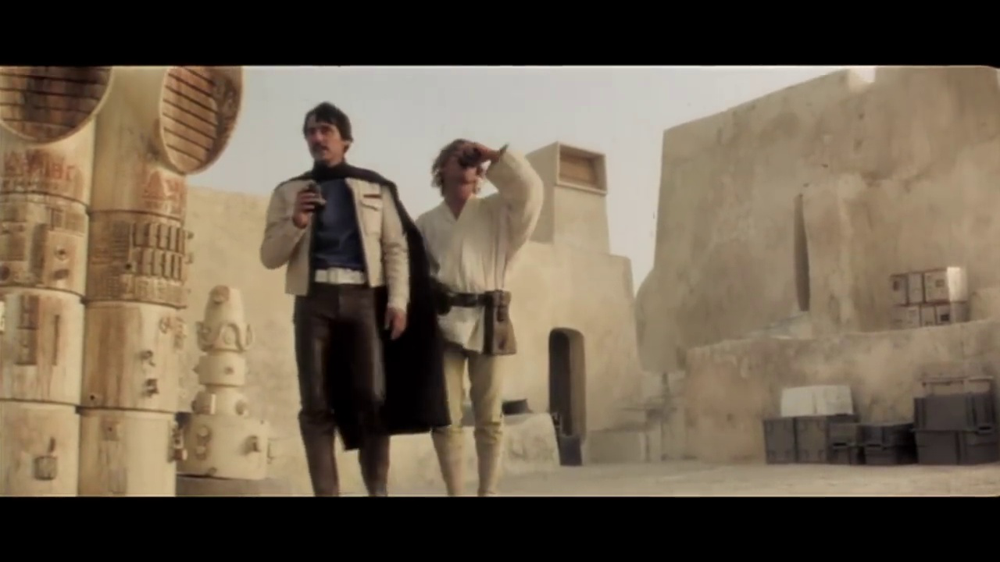

In [ ]:
import glob, random
file = random.choice(glob.glob(INFERENCE_FOLDER+'/images/*.*g'))
PIL.Image.open(file)

## Fastai inference

In [ ]:
class FeatureLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [ ]:
# learn = load_learner("/content/drive/My Drive/video_restorer/")
# learn = load_learner("/content/drive/My Drive/video_restorer3/")
# learn = load_learner("/content/drive/My Drive/video_restorer4/")
# learn = load_learner("/content/drive/My Drive/video_restorer5/")
learn = load_learner("/content/drive/My Drive/lh_restorer/")

In [ ]:
def run_inference_images(file, dest):

  img = open_image(file)
  p,img_hr,b = learn.predict(img)

  # Image(img_hr).save(dest)
  Image(img_hr).show(figsize=(25,25))
  plt.savefig(dest, bbox_inches = 'tight', pad_inches = 0)
  plt.close()

def scale_to_square(orig, targ, dest):
  # a simple stretch to fit a square really makes a big difference in rendering quality/consistency.
  # I've tried padding to the square as well (reflect, symetric, constant, etc).  Not as good!
  targ_sz = (targ, targ)
  orig = orig.resize(targ_sz, resample=PIL.Image.BILINEAR)
  orig.save(dest)
  return dest

def unsquare(image, orig, dest):
  targ_sz = orig.size
  image = image.resize(targ_sz, resample=PIL.Image.BILINEAR)
  image.save(dest)
  return dest

def adjust_brightness(img, factor, dest):
  enhancer = PIL.ImageEnhance.Brightness(img)
  img = enhancer.enhance(factor)
  os.remove(dest)
  img.save(dest)
  return img

def plot_img(path):
  plt.imshow(PIL.Image.open(path))
  plt.show()

In [ ]:
%%capture
render_factor = 40
ADJUST_BRIGHTNESS = False

if os.path.exists('imagepaths.txt'):
  os.remove('imagepaths.txt')

!rm -Rf $INFERENCE_FOLDER/high_res/
!mkdir $INFERENCE_FOLDER/high_res/

# def write_to_txt(dest):
#   file = open("imagepaths.txt", "a") 
#   write = "file '" + dest.strip() + "'" + "\n"
#   file.write(write) 
#   file.close() 

files = sorted(glob.glob(INFERENCE_FOLDER+'/images/*.*g'), key = lambda x: int(os.path.basename(x).split('.')[0]))
files = files[100:]

for file in tqdm(files):

  gc.collect()
  # file = random.choice(files)
  dest = INFERENCE_FOLDER+'/high_res/'+os.path.basename(file)
  # plot_img(file)

  # scale to square
  new_path = scale_to_square(PIL.Image.open(file), render_factor*16, dest = dest.split('.')[0]+'_square.jpg')

  # run inference
  run_inference_images(new_path, dest)
  # plot_img(new_path)

  # unsquare
  dest = unsquare(PIL.Image.open(dest), PIL.Image.open(file), dest = dest.split('.')[0]+'_unsquared.jpg')
  # plot_img(dest)

  # write to txt
  # write_to_txt(dest)

  # increase brightness
  if (ADJUST_BRIGHTNESS): adjust_brightness(PIL.Image.open(dest),factor = 1.5, dest=dest); plot_img(dest)


In [ ]:
import random
import PIL
import matplotlib.pyplot as plt

def combine_images_side_by_side(img1, img2, title):

  images = [PIL.Image.open(img1), PIL.Image.open(img2)]
  widths, heights = zip(*(i.size for i in images))

  total_width = sum(widths)
  max_height = max(heights)

  new_im = PIL.Image.new('RGB', (total_width, max_height))

  x_offset = 0
  for im in images:
    new_im.paste(im, (x_offset,0))
    x_offset += im.size[0]

  plt.imshow(new_im)
  plt.title(title)
  plt.show()

def get_original_photo(path):
  return str(path).replace('high_res', 'images').replace('_unsquared', '')

# files = glob.glob(INFERENCE_FOLDER+'/high_res/*_unsquared.*g')
# for file in random.sample(files, 5) :
#   combine_images_side_by_side(file, get_original_photo(file), title = 'fake/original')

In [ ]:
len(files)

## pix2pixHD infernece

In [ ]:
%cd /content
!git clone https://github.com/NVIDIA/pix2pixHD
%cd pix2pixHD

/content
fatal: destination path 'pix2pixHD' already exists and is not an empty directory.
/content/pix2pixHD


In [ ]:
INFERENCE_FOLDER = Path('content')/INFERENCE_FOLDER
shutil.move(str(INFERENCE_FOLDER/'images'), str(INFERENCE_FOLDER/'test_A'))

FileNotFoundError: ignored

In [ ]:
!rm -Rf /content/pix2pixHD/results/label2city
# python test.py --name label2city_1024p --netG local --ngf 32 --resize_or_crop none
!python test.py --resize_or_crop none --label_nc 0 --dataroot $INFERENCE_FOLDER --no_instance --checkpoints_dir /content/drive/MyDrive/$CHECKPOINT

------------ Options -------------
aspect_ratio: 1.0
batchSize: 1
checkpoints_dir: /content/drive/MyDrive/pix2pixHD_cue_mark_remover
cluster_path: features_clustered_010.npy
data_type: 32
dataroot: /content/inference
display_winsize: 512
engine: None
export_onnx: None
feat_num: 3
fineSize: 512
fp16: False
gpu_ids: [0]
how_many: 50
input_nc: 3
instance_feat: False
isTrain: False
label_feat: False
label_nc: 0
loadSize: 1024
load_features: False
local_rank: 0
max_dataset_size: inf
model: pix2pixHD
nThreads: 2
n_blocks_global: 9
n_blocks_local: 3
n_clusters: 10
n_downsample_E: 4
n_downsample_global: 4
n_local_enhancers: 1
name: label2city
nef: 16
netG: global
ngf: 64
niter_fix_global: 0
no_flip: False
no_instance: True
norm: instance
ntest: inf
onnx: None
output_nc: 3
phase: test
resize_or_crop: none
results_dir: ./results/
serial_batches: False
tf_log: False
use_dropout: False
use_encoded_image: False
verbose: False
which_epoch: latest
-------------- End ----------------
CustomDatasetData

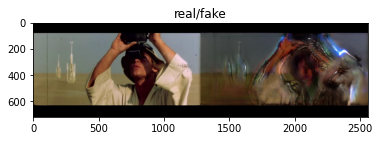

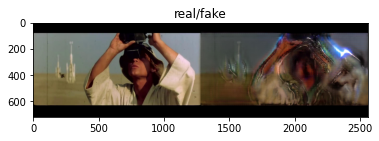

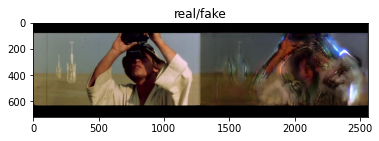

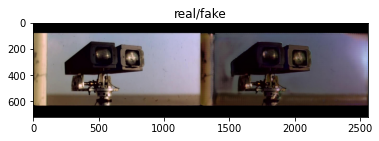

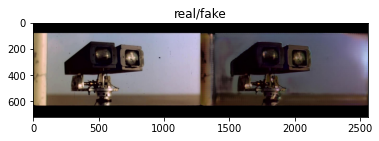

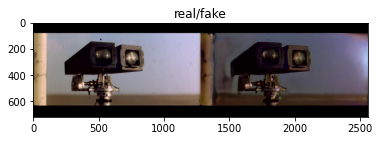

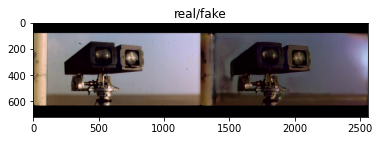

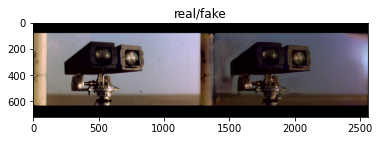

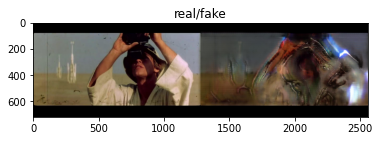

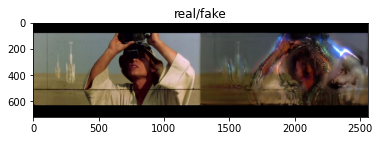

In [ ]:
def get_input_img(filepath):
  return str(filepath).replace('synthesized_image', 'input_label')

result_imgs = glob.glob('./results/*/test_latest/images/*synthesized_image.jpg')
for file in random.sample(result_imgs, 10):
  synthesized = file
  input = get_input_img(synthesized)
  combine_images_side_by_side(input, synthesized, title = 'real/fake')

## Concat to video

In [ ]:
pathOut = 'inference_after.mp4'

In [ ]:
show_short_video(VIDEO)

/content/inference_before_short.mp4


In [ ]:
import cv2
import numpy as np
import os
from tqdm.notebook import tqdm

cap = cv2.VideoCapture(VIDEO)
clean_fps = cap.get(cv2.CAP_PROP_FPS)
print(clean_fps)

try: os.remove(pathOut)
except: pass

fps = clean_fps
frame_array = []

files = sorted(glob.glob('./results/*/test_latest/images/*synthesized_image.jpg'), key = lambda x: int(os.path.basename(x).split('.')[0].split('_')[0]))
print(len(files))

for filename in tqdm(files):
    # reading each files
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width,height)
    
    # inserting the frames into an image array
    frame_array.append(img)

out = cv2.VideoWriter(pathOut,cv2.VideoWriter_fourcc(*'MP4V'), fps, size)
for i in range(len(frame_array)):
    # writing to a image array
    out.write(frame_array[i])
out.release()

24.0
50


In [ ]:
copy_file_to_drive(pathOut, 'pix2pixHD_cue_mark_remover')
copy_file_to_drive(VIDEO, 'pix2pixHD_cue_mark_remover')